In [ ]:
from keras.models import Sequential # modelo da rede neural
from keras.layers import Dense, Dropout, GRU # tipos de camadas que serao usadas
import keras
from sklearn.preprocessing import MinMaxScaler # normalizados de dados
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error
from keras.utils import plot_model # usado para plotar modelo da rede neural
import numpy as np # permite trabalhar com vetores e matrizes
import pandas as pd # permite manipulacao e analise de dados
import matplotlib.pyplot as plt # ferramenta para plotagem
import warnings

# Nova seção

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import math
df = pd.read_csv('/content/dados_isquemicas.csv')

qtde_valores_modelo = math.ceil(len(df) * 0.8)
base_treinamento = df.iloc[0:qtde_valores_modelo, 3:4].values # intervalo de dados para treinamento
base_teste = df.iloc[qtde_valores_modelo:, 3:4].values # intervalo de dados para teste da rede neural
ano_teste = (df.iloc[qtde_valores_modelo:, 2:3].values)
base_completa = df.iloc[0:, 3:4].values # carrega a base completa
print(len(base_treinamento), len(base_teste), len(base_completa))

normalizador = MinMaxScaler(feature_range=(0, 1)) # configura o normalizador entre 0 e 1

base_treinamento_normalizada = normalizador.fit_transform(base_treinamento) # faz a normalizacao dos dados


164 40 204


Epoch 1/50
6/6 [==============================] - 8s 17ms/step - loss: 0.2667 - mean_absolute_error: 0.4478
Epoch 2/50
6/6 [==============================] - 0s 15ms/step - loss: 0.0488 - mean_absolute_error: 0.1815
Epoch 3/50
6/6 [==============================] - 0s 17ms/step - loss: 0.0843 - mean_absolute_error: 0.2528
Epoch 4/50
6/6 [==============================] - 0s 18ms/step - loss: 0.0454 - mean_absolute_error: 0.1725
Epoch 5/50
6/6 [==============================] - 0s 28ms/step - loss: 0.0338 - mean_absolute_error: 0.1409
Epoch 6/50
6/6 [==============================] - 0s 28ms/step - loss: 0.0418 - mean_absolute_error: 0.1551
Epoch 7/50
6/6 [==============================] - 0s 28ms/step - loss: 0.0389 - mean_absolute_error: 0.1501
Epoch 8/50
6/6 [==============================] - 0s 28ms/step - loss: 0.0344 - mean_absolute_error: 0.1401
Epoch 9/50
6/6 [==============================] - 0s 22ms/step - loss: 0.0321 - mean_absolute_error: 0.1399
Epoch 10/50
6/6 [===========

<ipython-input-4-2730c66eef88>:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows = 1, ncols = 1, figsize = [16, 6])


Streaming output truncated to the last 5000 lines.
Epoch 173/200
5/5 [==============================] - 0s 37ms/step - loss: 0.0201 - mean_absolute_error: 0.1119
Epoch 174/200
5/5 [==============================] - 0s 36ms/step - loss: 0.0199 - mean_absolute_error: 0.1100
Epoch 175/200
5/5 [==============================] - 0s 37ms/step - loss: 0.0203 - mean_absolute_error: 0.1109
Epoch 176/200
5/5 [==============================] - 0s 36ms/step - loss: 0.0199 - mean_absolute_error: 0.1106
Epoch 177/200
5/5 [==============================] - 0s 39ms/step - loss: 0.0198 - mean_absolute_error: 0.1096
Epoch 178/200
5/5 [==============================] - 0s 37ms/step - loss: 0.0199 - mean_absolute_error: 0.1110
Epoch 179/200
5/5 [==============================] - 0s 36ms/step - loss: 0.0198 - mean_absolute_error: 0.1103
Epoch 180/200
5/5 [==============================] - 0s 43ms/step - loss: 0.0200 - mean_absolute_error: 0.1109
Epoch 181/200
5/5 [==============================] - 0s 43ms/

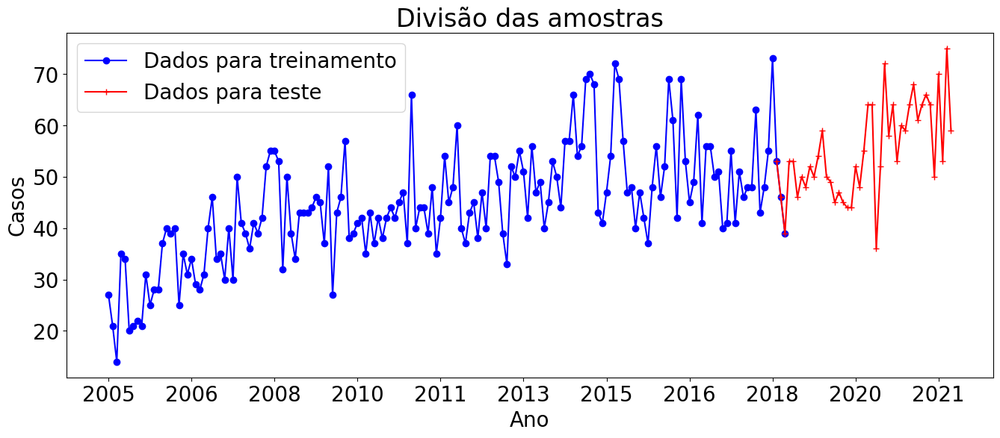

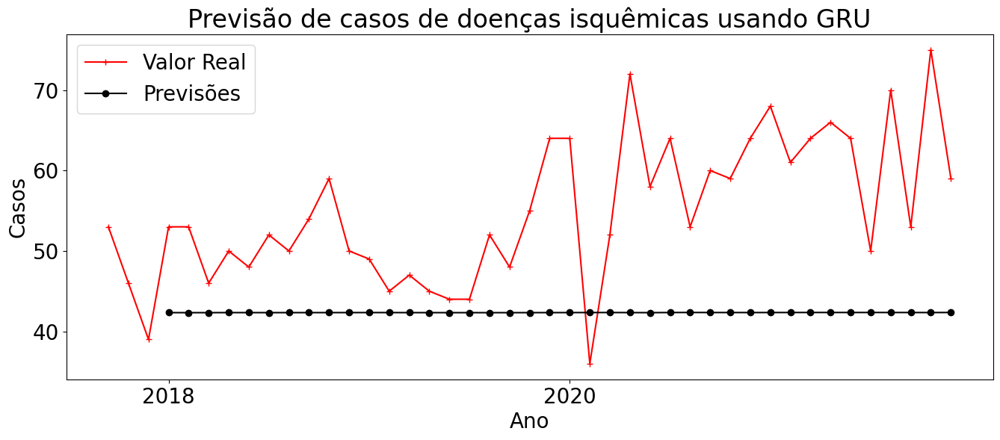

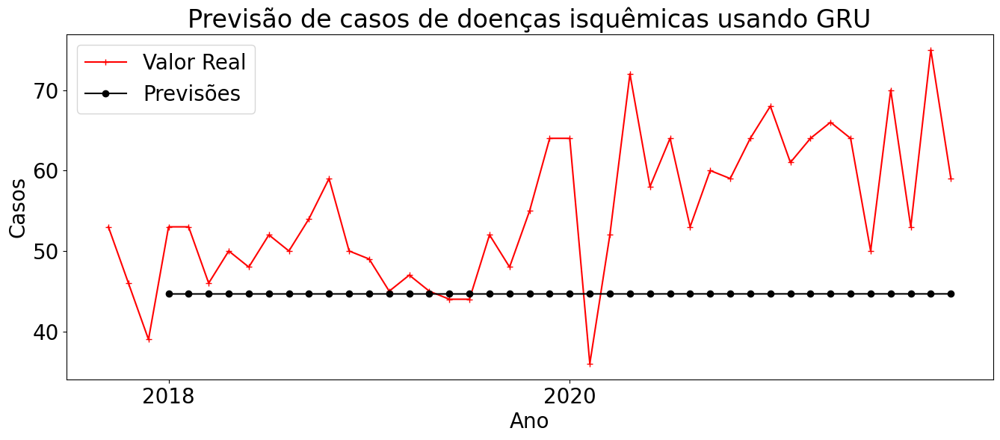

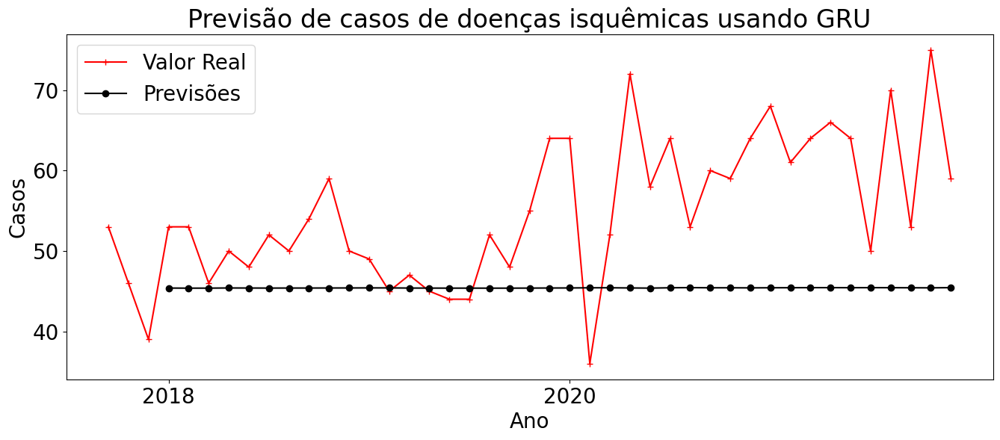

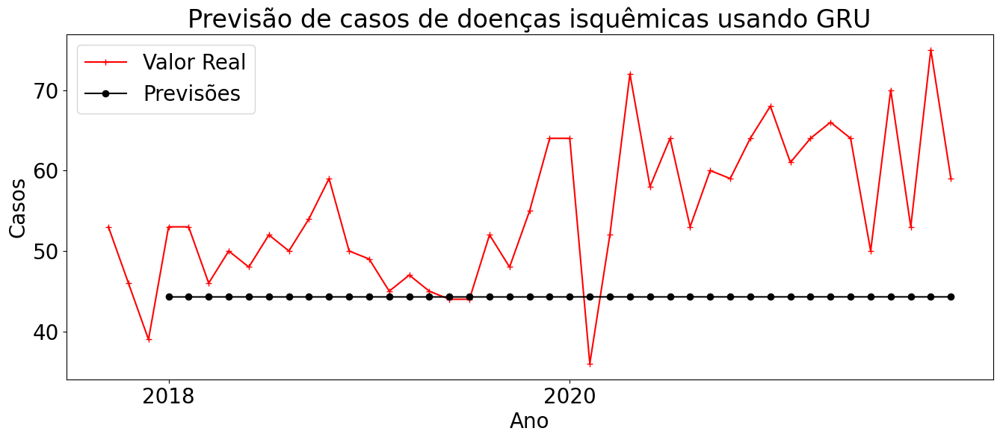

...

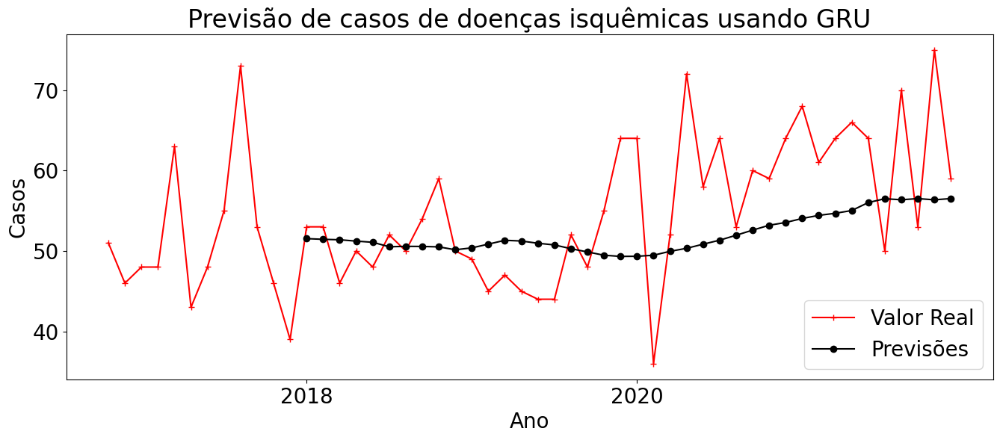

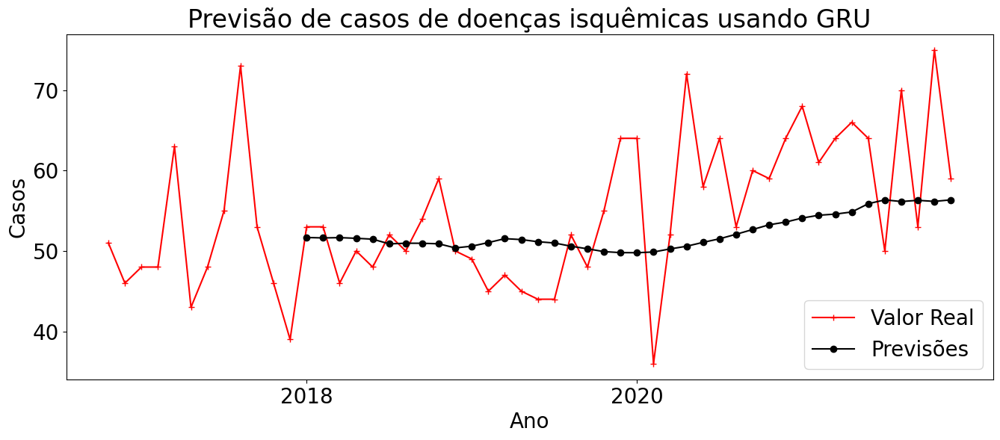

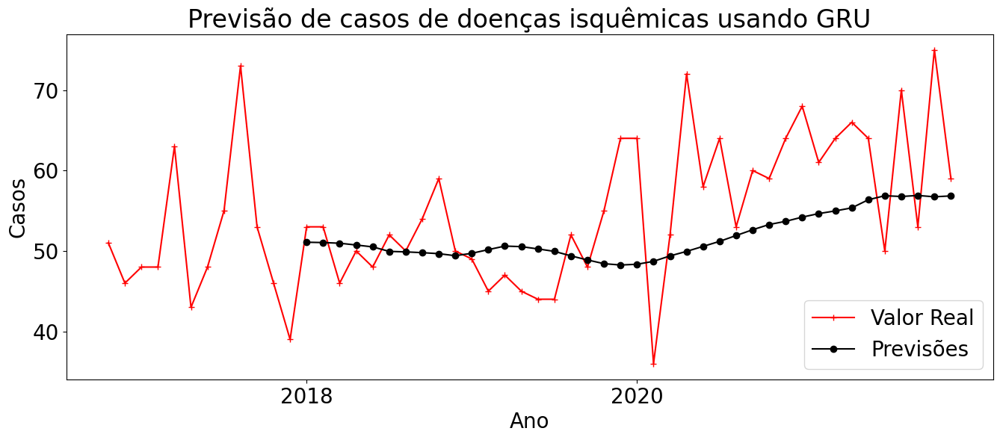

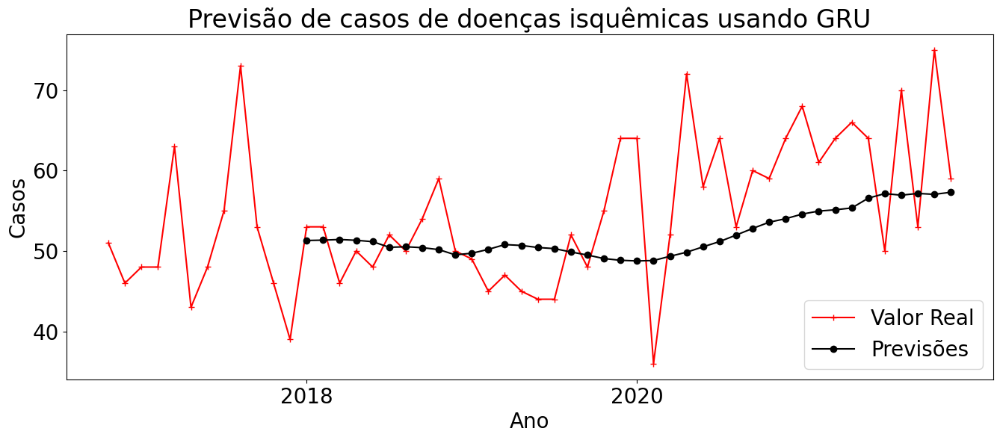

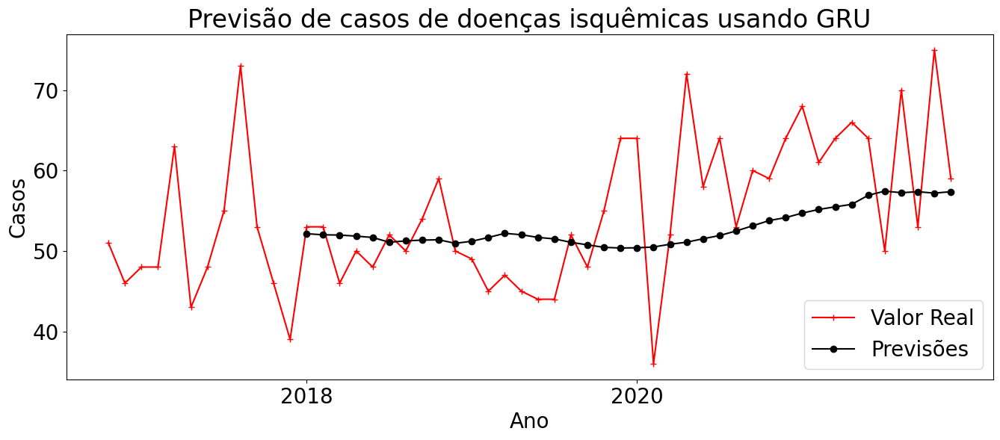

In [ ]:
for a in ['tanh','sigmoid','softplus','softsign','elu','selu','relu']:
  for step in [3,5,8,12]:
    time_step = step

    valor_real = [] # variavel que recebe o valor real de cada previsao que sera feita no treinamento
    previsores = [] # variavel que recebe a entrada da rede neural

    for i in range(time_step, len(base_treinamento)):
      previsores.append(base_treinamento_normalizada[i - time_step:i, 0])
      valor_real.append(base_treinamento_normalizada[i, 0])
    previsores, valor_real = np.array(previsores), np.array(valor_real) # passa os valores para array somente
    previsores = np.reshape(previsores, (previsores.shape[0], previsores.shape[1], 1)) # prepara os valores
    n_previsores = len(previsores)
    n_real = len(valor_real)
    ttr = list(range(len(base_treinamento)))
    tts = list(range(len(base_treinamento) - time_step, len(base_completa)))
    tts1 = tts[time_step:]
    # dados que foram para o treinamento
    data_train = base_treinamento.transpose().tolist()
    data_train = data_train[0]

    # dados para o teste
    data_test = base_completa[len(base_completa) - len(base_teste) - time_step:]
    data_test = data_test.transpose().tolist()
    data_test = data_test[0]
    plt.rcParams.update({'font.size': 20})
    fig, ax = plt.subplots(nrows = 1, ncols = 1, figsize = [16, 6])
    plt.plot(ttr, data_train, color = 'blue', label = 'Dados para treinamento', marker = "o")
    plt.plot(tts, data_test, color = 'red', label = 'Dados para teste', marker = "+")
    plt.xticks(range(0,df.shape[0],20), df['ANO'].loc[::20], rotation=0)
    plt.title('Divisão das amostras')
    plt.xlabel('Ano')
    plt.ylabel('Casos')
    plt.legend()
    plt.savefig('/content/drive/MyDrive/monografia/INFO_MODEL/divisao/divisao_amostras_step{time_step}_GRU.png', format = 'png', bbox_inches='tight')
      # cria uma base de dados com entradas (previsores) e tags (valor_real) para o treinar a rede.

    for n in [32,64,128]:
      qtde_neuronios = n

      # configura o otimizador da rede neural
      # optimizer -> otimizador usado pela rede
      # loss --> usado para ajuste dos pesos
      # metrics --> para entender os resultados
      for e in [50,100,200]:
        epochs = e
        regressor = Sequential() # cria a rede neural

        # camada de entrada  e  camada oculta da rede neural
        # units -> numero de neuronios ou ctanhlas de memoria na camada
        # return_sequences = True, -> indica que deve passar informacao pra frente para outras camadas
        # input_shape -->  valores na primeira camada
        regressor.add(GRU(activation=a,units = qtde_neuronios, return_sequences = True, input_shape = (previsores.shape[1], 1)))
        regressor.add(GRU(activation=a,units = qtde_neuronios, return_sequences = True, input_shape = (previsores.shape[1], 1)))
        # terceira camada oculta
        regressor.add(GRU(activation=a,units = qtde_neuronios))


        # camada saida
        # units -> uma saida
        regressor.add(Dense(1))

        opt = keras.optimizers.RMSprop()

        regressor.compile(optimizer = opt, loss = 'mean_squared_error', metrics = ['mean_absolute_error'])
      # plota a rede neural
        #plot_model(regressor, to_file = 'prev_gru/model_camadas5_neuronios{qtde_neuronios}.png', show_shapes = 'true', expand_nested = 'true')

        regressor.fit(previsores, valor_real, epochs = epochs)
        entradas = base_completa[len(base_completa) - len(base_teste) - time_step:]
        entradas = entradas.reshape(-1, 1) # somente para ficar no formato do numpy
        entradas = normalizador.transform(entradas) # normaliza entre 0 e 1

        entradas_train = base_completa[:len(base_treinamento) + time_step]
        entradas_train = entradas_train.reshape(-1,1)
        entradas_train = normalizador.transform(entradas_train)

        X_teste = [] # variavel que vai receber as novas entradas para rede neural
        X_teste_train = [] # variavel que vai receber as novas entradas para rede neural da base de treinamento

      # prepara os valores para entrar na rede
        for i in range(time_step, len(entradas)):
          X_teste.append(entradas[i - time_step:i, 0])

        for i in range(time_step, len(entradas_train)):
          X_teste_train.append(entradas_train[i-time_step:i,0])

        X_teste = np.array(X_teste)
        X_teste_train = np.array(X_teste_train)

    # prepara os valores para entrada de acordo com o pacote keras
        X_teste = np.reshape(X_teste, (X_teste.shape[0], X_teste.shape[1], 1))
        X_teste_train = np.reshape(X_teste_train, (X_teste_train.shape[0], X_teste_train.shape[1],1))
    # realiza previsoes
        previsoes = regressor.predict(X_teste)
        previsoes = normalizador.inverse_transform(previsoes) # desnormaliza os valores

        previsoes_train = regressor.predict(X_teste_train)
        previsoes_train = normalizador.inverse_transform(previsoes_train)

    # calcula as metricas
        #RMSE do conjunto de treinamento
        mse_t = mean_squared_error(base_treinamento, previsoes_train)
        rmse_t = np.sqrt(mse_t)
        #MAPE do conjunto de treinamento
        mape_t = mean_absolute_percentage_error(base_treinamento,previsoes_train)
        #RMSE do conjunto de testes
        mse_v = mean_squared_error(base_teste, previsoes)
        rmse_v = np.sqrt(mse_v)
        #MAPE do conjunto de
        mape_v = mean_absolute_percentage_error(base_teste, previsoes)



    # plota os resultados

    # vetor para o eixo x do grafico
        ttr = list(range(len(base_treinamento)))
        tts = list(range(len(base_treinamento) - time_step, len(base_completa)))
        tts1 = tts[time_step:]

        # dados para o teste
        data_test = base_completa[len(base_completa) - len(base_teste) - time_step:]
        data_test = data_test.transpose().tolist()
        data_test = data_test[0]

        plt.rcParams.update({'font.size': 20}) # configura a fonte do texto do grafico
        fig, ax = plt.subplots(nrows = 1, ncols = 1, figsize = [16, 6]) # tamanho da figura
        plt.plot(tts, data_test, color = 'red', label = 'Valor Real', marker = "+") # plota os dados reais
        plt.plot(tts1, previsoes, color = 'black', label = 'Previsões', marker = "o") # plota os dados preditos
        plt.title('Previsão de casos de doenças isquêmicas usando GRU')
        plt.xticks(range(qtde_valores_modelo,df.shape[0],20), df['ANO'].loc[qtde_valores_modelo::20], rotation=0)
        plt.xlabel('Ano')
        plt.ylabel('Casos')
        plt.legend()
        #plt.savefig(f'/content/drive/MyDrive/monografia/INFO_MODEL/IMG_GRU/ADAGARD_tahn__prev_casos_camadas3_neuronios{qtde_neuronios}_epocas{epochs}_taxa{learning_r}.png', format = 'png', bbox_inches='tight') # salva em uma figura
        plt.savefig(f'/content/drive/MyDrive/monografia/INFO_MODEL/NOVO_IMG_GRU/GRU_RMSprop_{a}_{step}_{n}_{e}_prev_casos_camadas3_neuronios{qtde_neuronios}_epocas{epochs}.png', format = 'png', bbox_inches='tight') # salva em uma figura
        #plt.show()

        # # apresenta as metricas
        # rmse_v = mean_squared_error(base_teste, previsoes)
        # mape_v = mean_absolute_percentage_error(base_teste, previsoes)
        # rows = []
        # rows.append([rmse_v, mape_v])
        # pd.DataFrame(rows, columns=['RMSE', 'MAPE'])
        import csv

        filename = f"/content/drive/MyDrive/monografia/INFO_MODEL/GRU/hiperp_metricas_RMSprop.csv"

        # Abre o arquivo csv em modo de leitura


            # Cria um novo conjunto de informações
        #novas_informacoes = ['3', str(qtde_neuronios),str(time_step), epochs,(learning_r),rmse_v,mape_v]
        novas_informacoes = ['3', a, str(qtde_neuronios),str(time_step), epochs, rmse_t, mape_t, rmse_v,mape_v]

            # Adiciona o novo conjunto de informações ao arquivo
        with open(filename, 'a', newline='') as f:
                # Cria um novo objeto `writer`
            writer = csv.writer(f)

                # Escreve o novo conjunto de informações no arquivo
            writer.writerow(novas_informacoes)


# Nova seção